# Replicating Sweepgraph Functionality using Thicket

`RAJAPerf/scripts/sweep_graph.py` provides specialized plots of RAJAPerf csv data. This is a replication of the same functionality using RAJAPerf caliper data in conjunction with the Thicket ensemble analysis tool.

In [1]:
import sys

sys.path.append("/usr/gapps/spot/dev/hatchet-venv/x86_64/lib/python3.10/site-packages")
sys.path.append("/usr/gapps/spot/dev/hatchet/x86_64/")
sys.path.append("/usr/gapps/spot/dev/thicket-playground-dev/")

from glob import glob

import pandas as pd

import hatchet as ht
import thicket as th

pd.set_option("display.max_rows", None)
pd.set_option("display.max_columns", None)

<IPython.core.display.Javascript object>

### Custom plotting functions mimicking sweepgraph functionality

In [2]:
from plot import plot

### Query function

In [3]:
# Query to only get the leaves in the tree.
leaf_query = ht.query.QueryMatcher().match(
    ".",
    lambda row: row.index.get_level_values("node").to_series().apply(
        lambda n: len(n.children) == 0
    ).all()
)

/usr/WS1/mckinsey/venv/python-3.7.4/lib/python3.7/site-packages/ipykernel_launcher.py:2: DeprecationWarning: Old-style queries are deprecated and will be removed in the                     future. Please use new-style queries instead.                     For QueryMatcher, the equivalent new-style queries are                     hatchet.query.Query for base-syntax queries and                     hatchet.query.ObjectQuery for the object-dialect.
  


### Ensembling operations to achieve desired data composition

In [4]:
# Read data from 1 trial
tk_full = th.Thicket.from_caliperreader(glob("/usr/workspace/thicket/rajaperf-july-2023/lassen/**/1/*.cali"))

# Groupby variant and tuning
tkdict_var_tun = tk_full.groupby(["variant", "tuning"])
# Create columnar joined thicket from subset
tk_var_tun = th.Thicket.columnar_join(
    thicket_list=list(tkdict_var_tun.values()),
    header_list=list(tkdict_var_tun.keys()),
    column_name="ProblemSizeRunParam"
)

# Groupby variant, tuning, and problemsize
tkdict_var_tun_prob = tk_full.groupby(["variant", "tuning", "ProblemSizeRunParam"])
# CJ Thicket from subset
variants = tk_full.metadata["variant"].unique()
tuning = "block_128"
prob_size = 1048576
tk_var_b128_1M = th.Thicket.columnar_join(
    thicket_list=[tkdict_var_tun_prob[v, tuning, prob_size] for v in variants],
    header_list=variants,
    column_name="ProblemSizeRunParam"
)

10  thickets created...
{('Base_CUDA', 'block_1024'): <thicket.thicket.Thicket object at 0x1554bcdfbfd0>, ('Base_CUDA', 'block_128'): <thicket.thicket.Thicket object at 0x1554bcc21e10>, ('Base_CUDA', 'block_256'): <thicket.thicket.Thicket object at 0x1554bcc2ca90>, ('Base_CUDA', 'block_512'): <thicket.thicket.Thicket object at 0x1554bce09050>, ('Base_CUDA', 'library'): <thicket.thicket.Thicket object at 0x1554bcaf5290>, ('RAJA_CUDA', 'block_1024'): <thicket.thicket.Thicket object at 0x1554bcc07690>, ('RAJA_CUDA', 'block_128'): <thicket.thicket.Thicket object at 0x1554bcc13890>, ('RAJA_CUDA', 'block_256'): <thicket.thicket.Thicket object at 0x1554bcaf7050>, ('RAJA_CUDA', 'block_512'): <thicket.thicket.Thicket object at 0x1554bce0c410>, ('RAJA_CUDA', 'library'): <thicket.thicket.Thicket object at 0x1554bc5706d0>}
40  thickets created...
{('Base_CUDA', 'block_1024', 1048576.0): <thicket.thicket.Thicket object at 0x1554bc538e10>, ('Base_CUDA', 'block_1024', 2097152.0): <thicket.thicket.Thi

# Plotting

/usr/WS1/mckinsey/venv/python-3.7.4/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:337: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


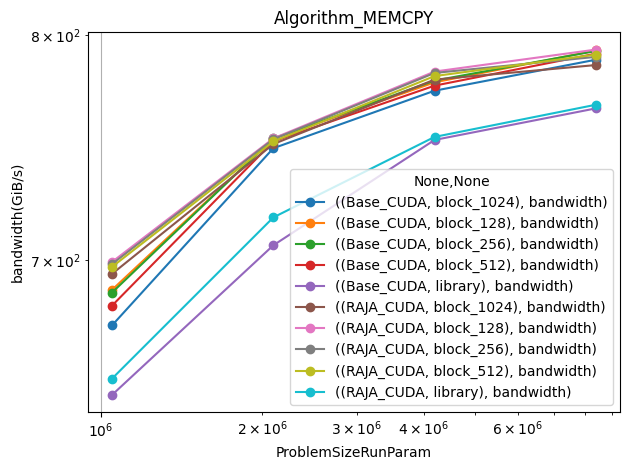

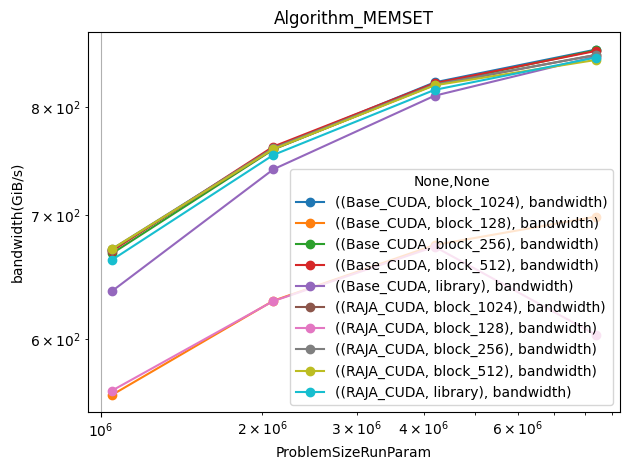

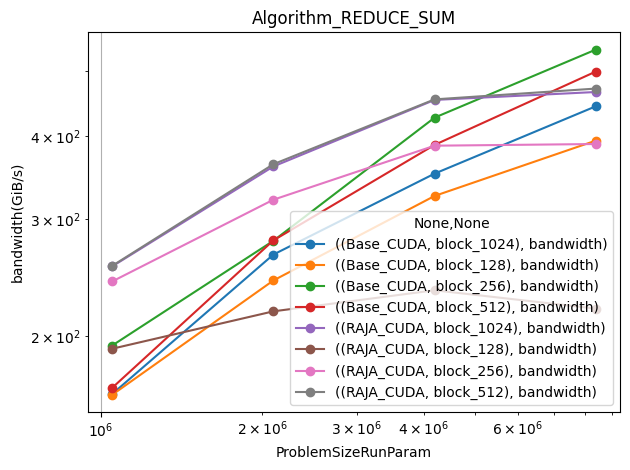

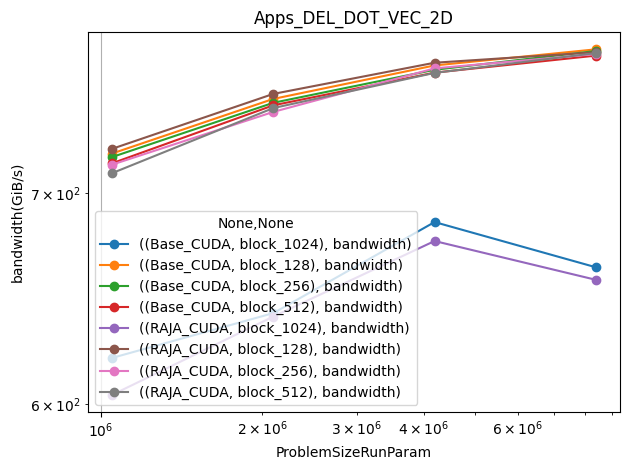

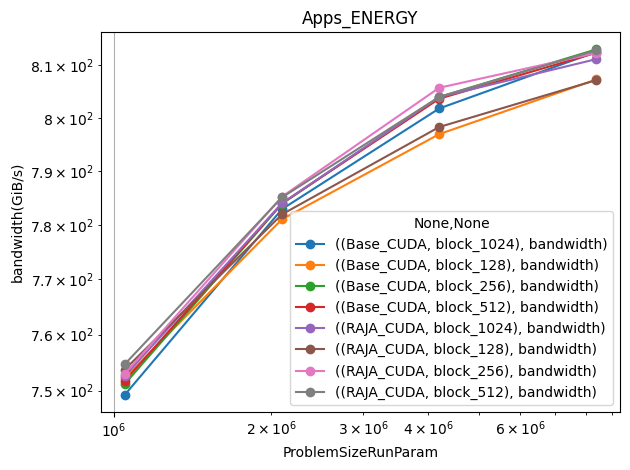

...

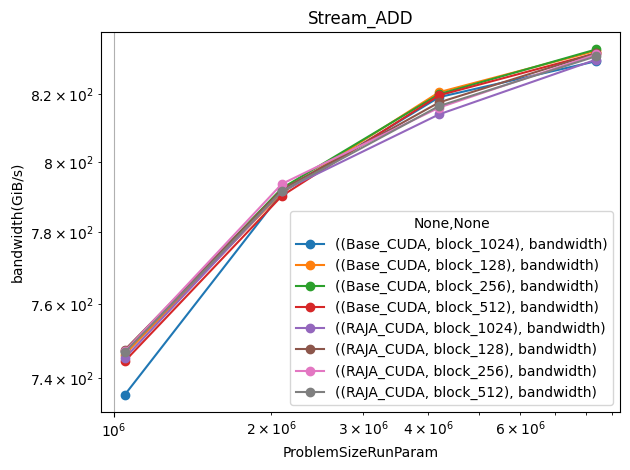

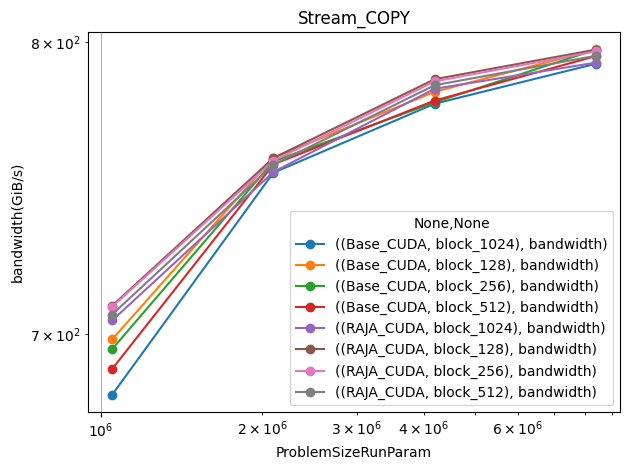

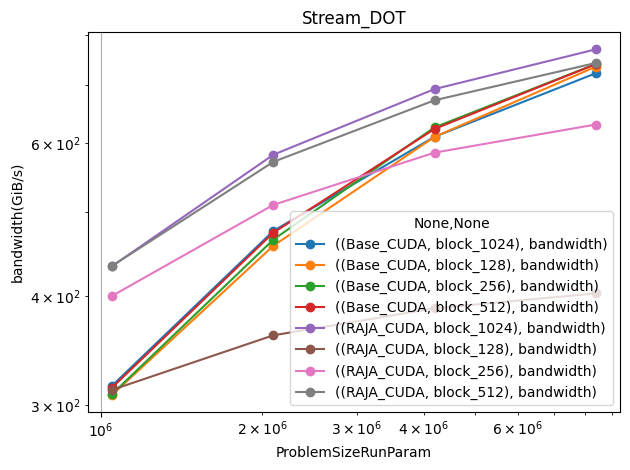

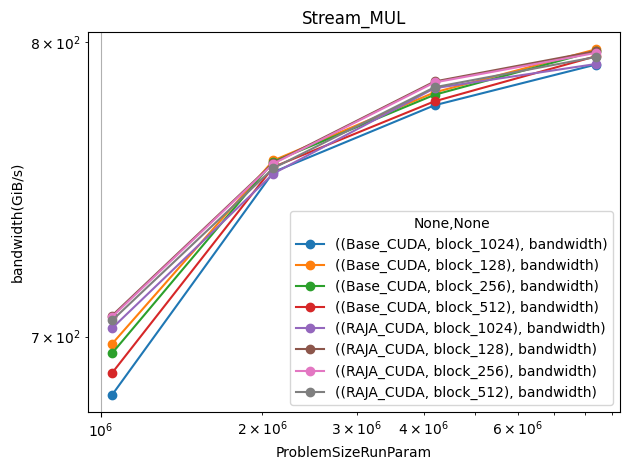

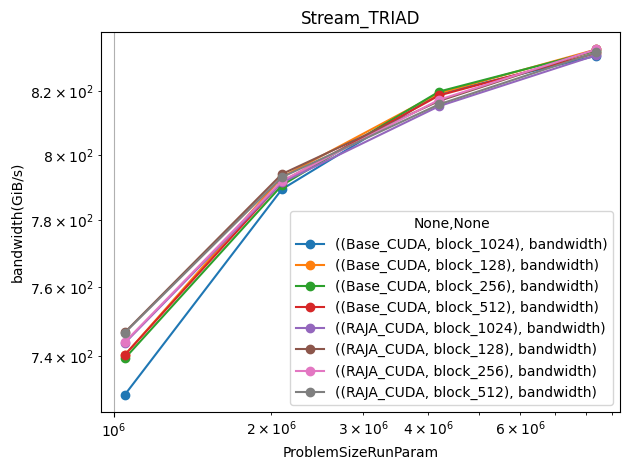

In [5]:
bandwidth_line_df = plot(
    thicket=tk_var_tun.query(leaf_query, update_inc_cols=False),
    kind="line",
    metric="bandwidth",
)

/usr/WS1/mckinsey/venv/python-3.7.4/lib/python3.7/site-packages/pandas/plotting/_matplotlib/core.py:549: UserWarning: Data has no positive values, and therefore cannot be log-scaled.
  labels = axis.get_majorticklabels() + axis.get_minorticklabels()


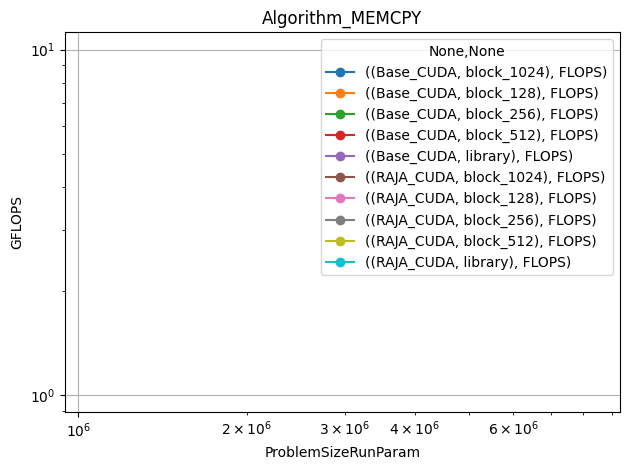

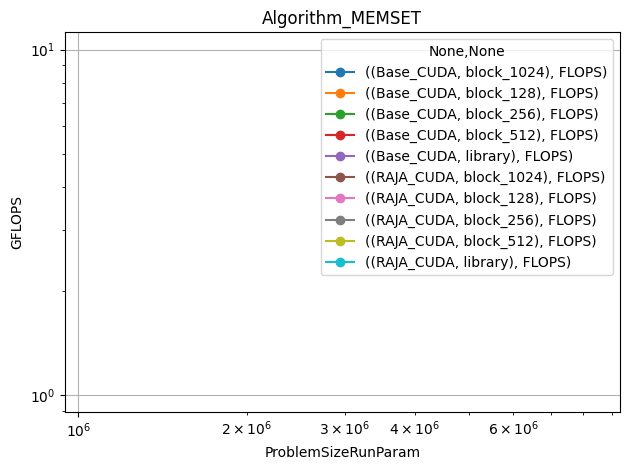

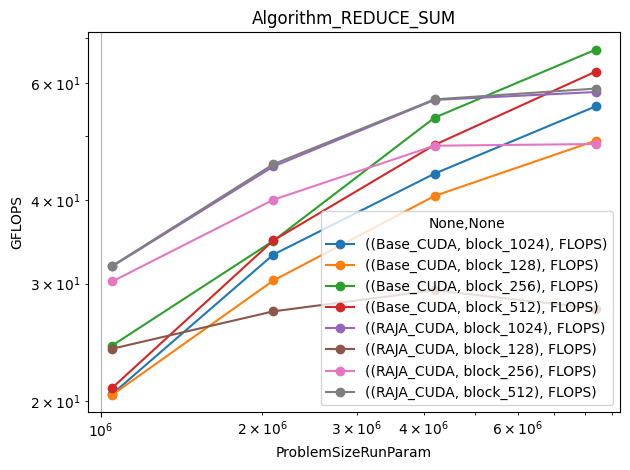

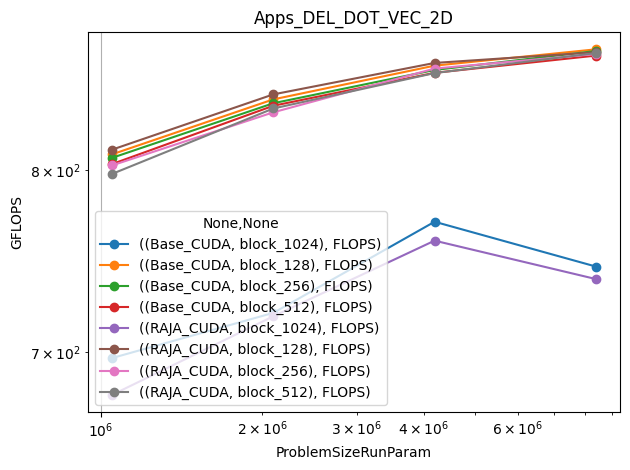

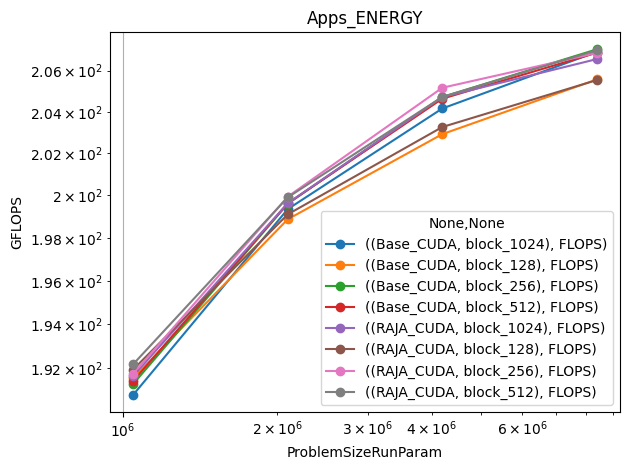

...

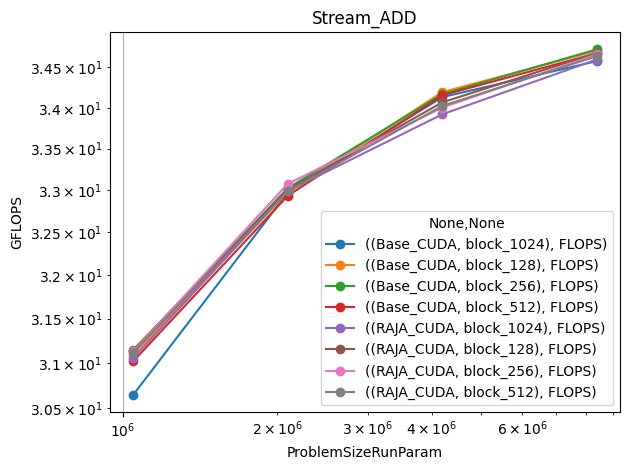

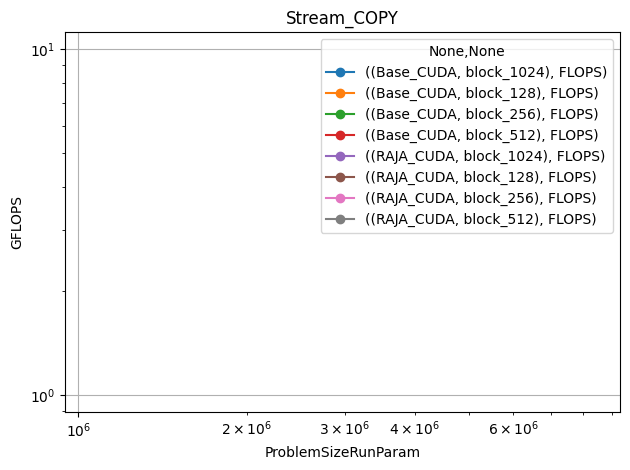

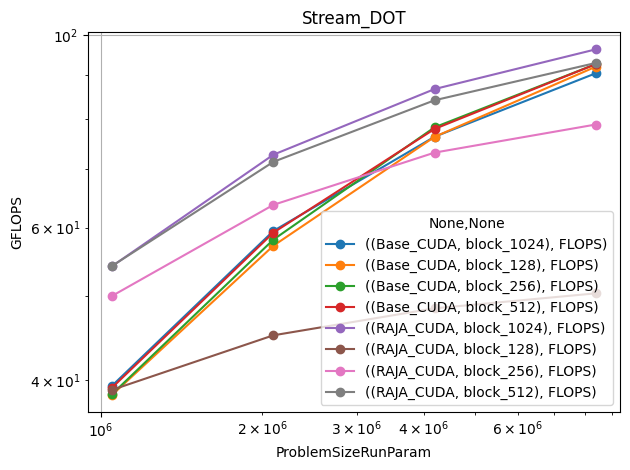

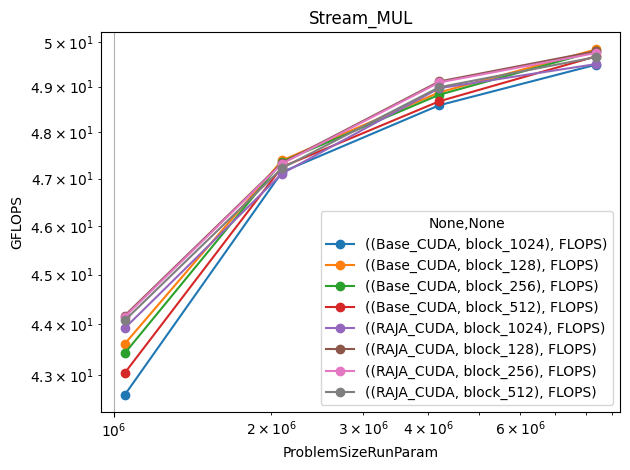

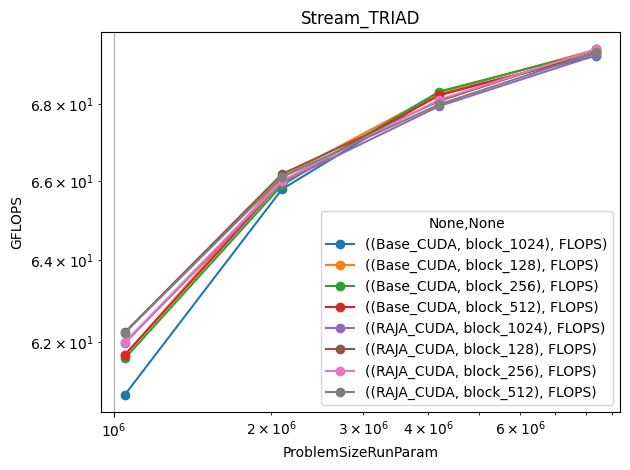

In [6]:
flops_line_df = plot(
    thicket=tk_var_tun.query(leaf_query, update_inc_cols=False),
    kind="line",
    metric="FLOPS",
)

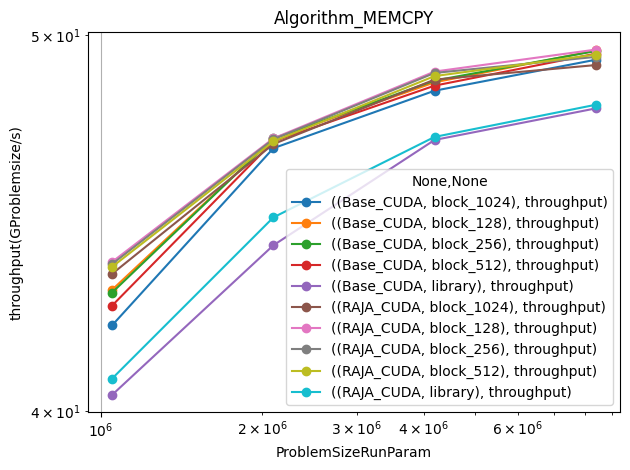

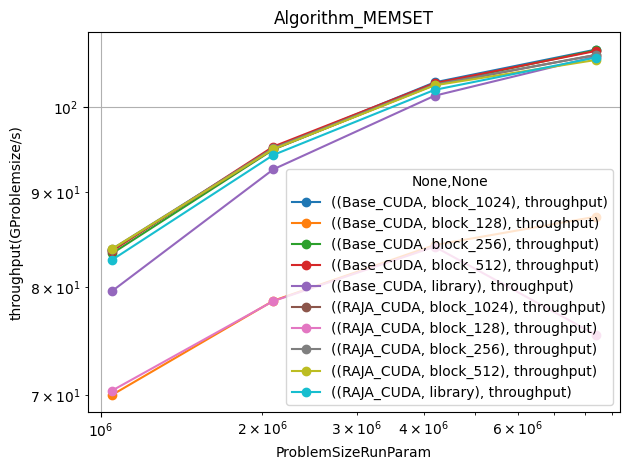

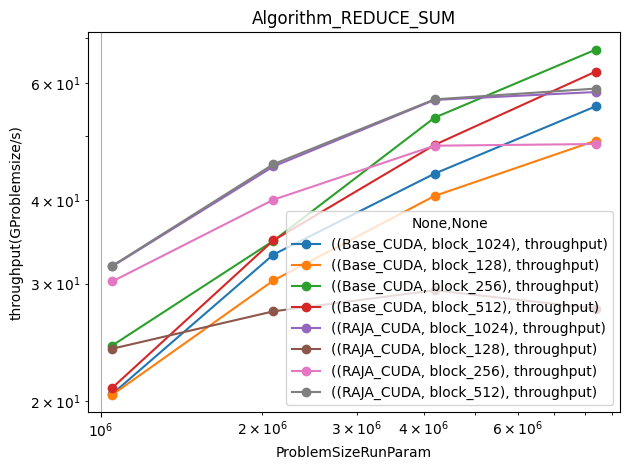

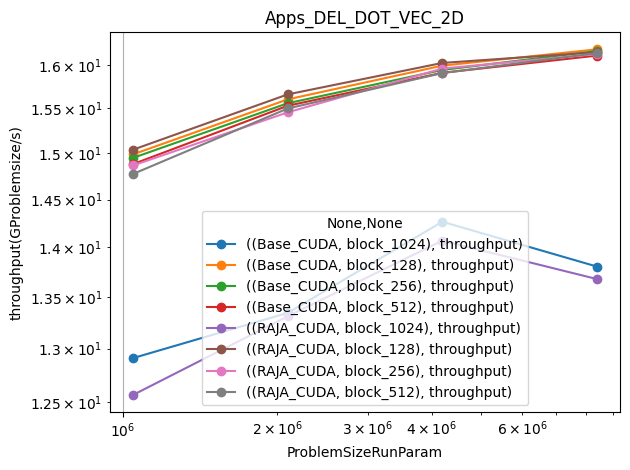

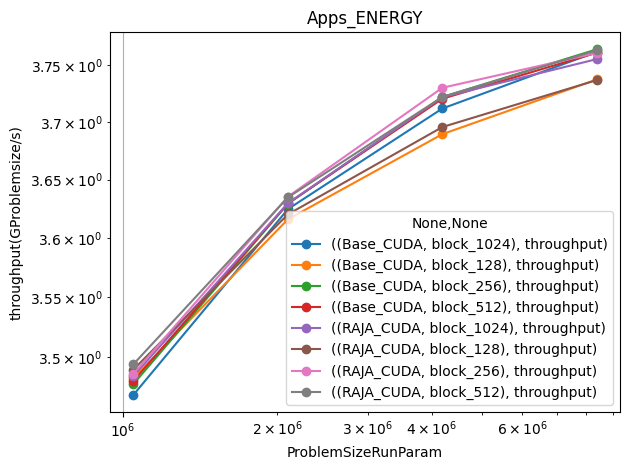

...

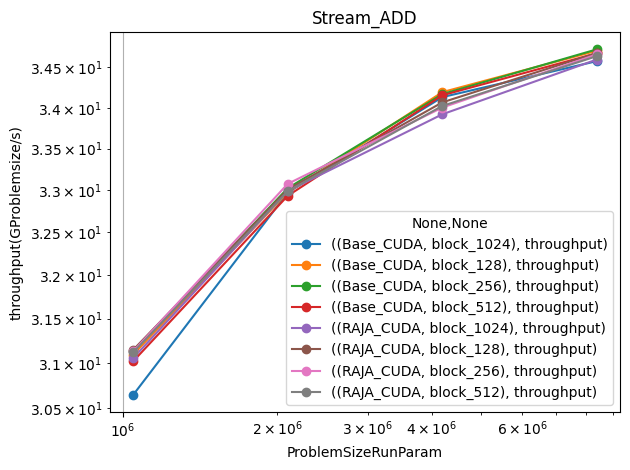

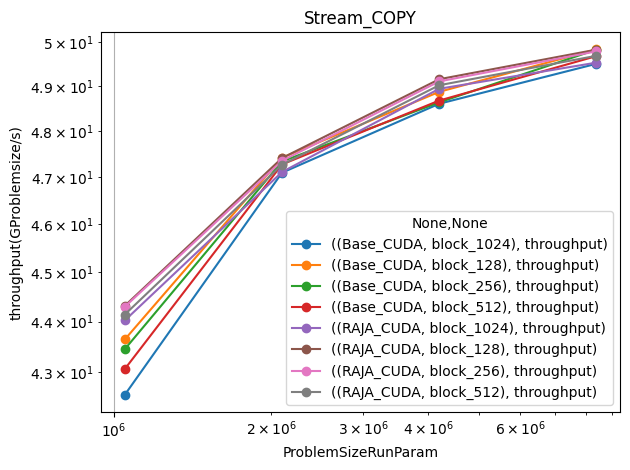

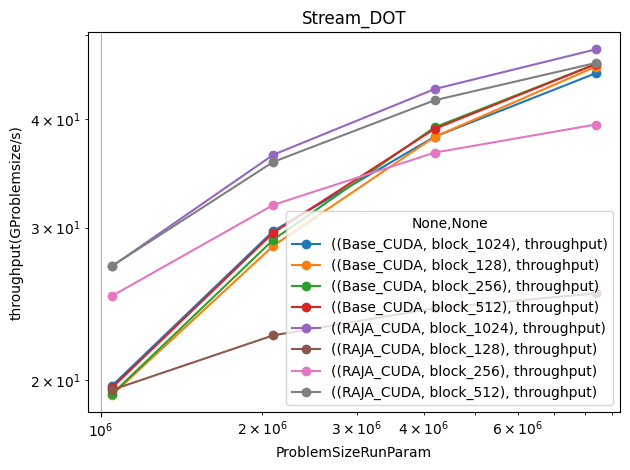

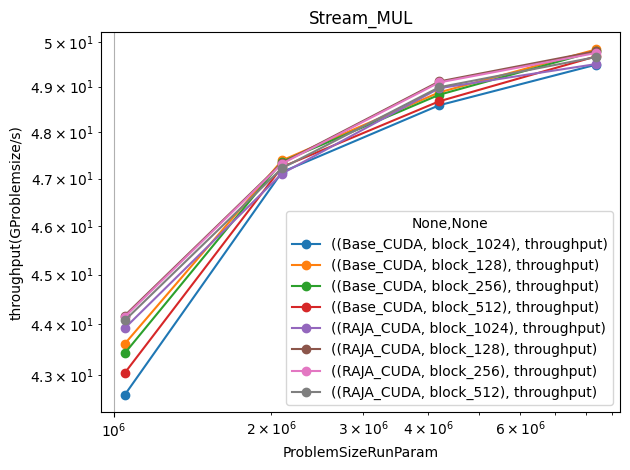

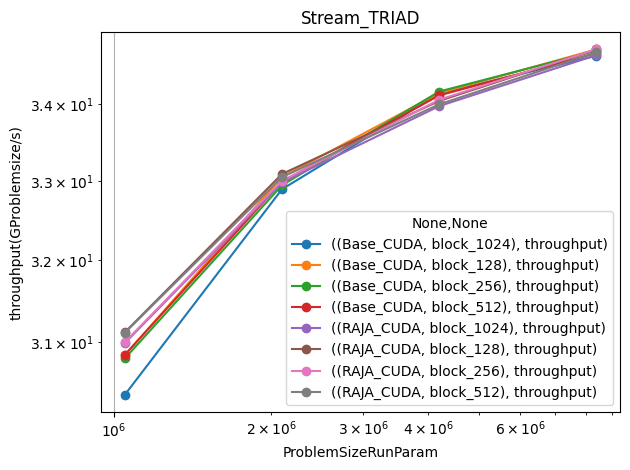

In [7]:
throughput_line_df = plot(
    thicket=tk_var_tun.query(leaf_query, update_inc_cols=False),
    kind="line",
    metric="throughput",
)

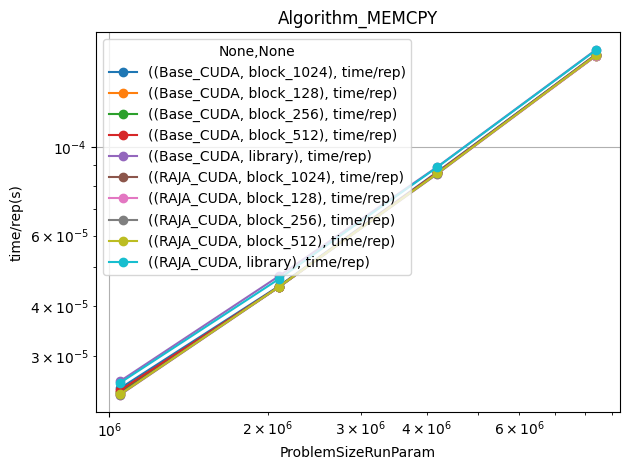

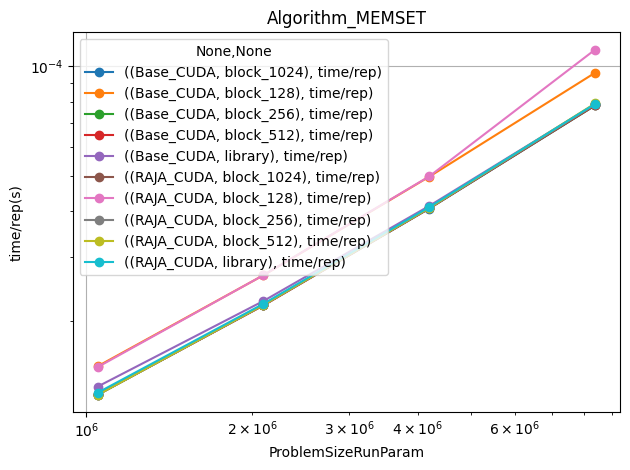

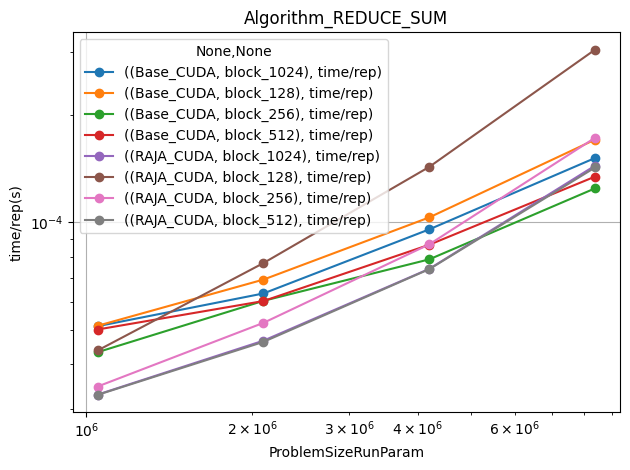

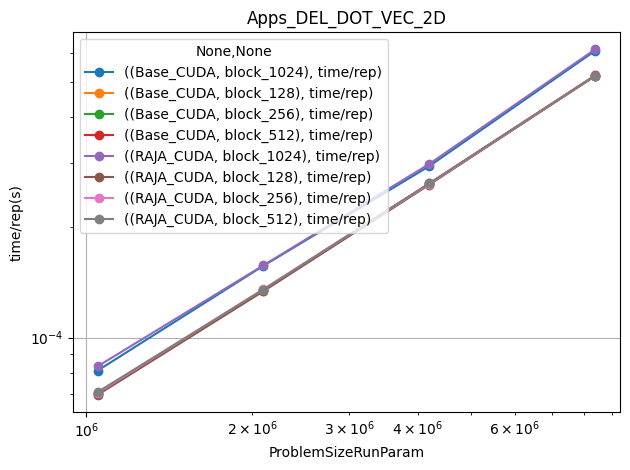

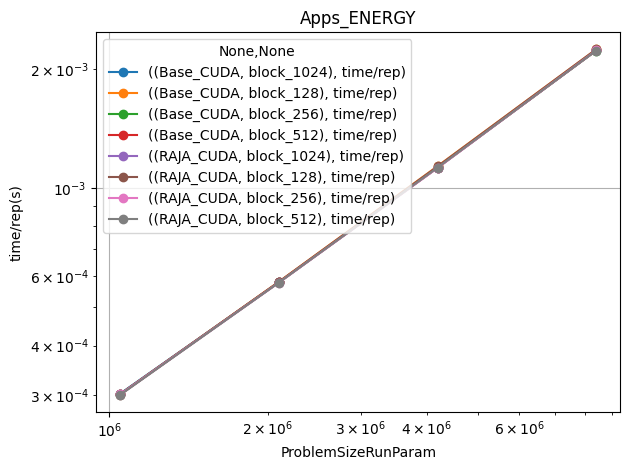

...

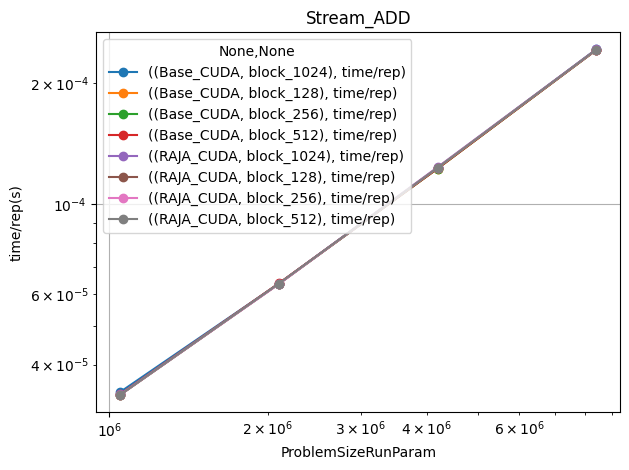

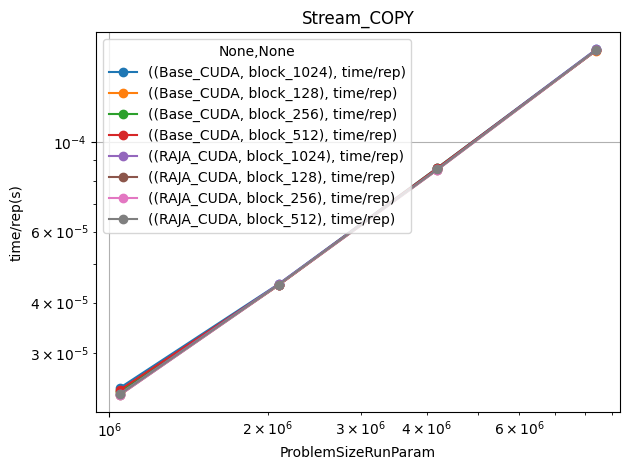

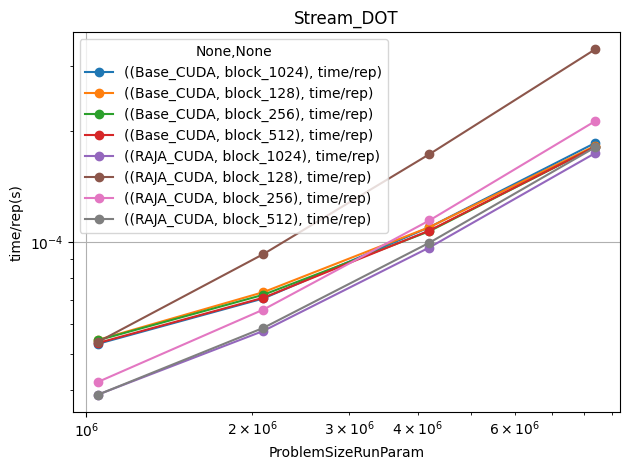

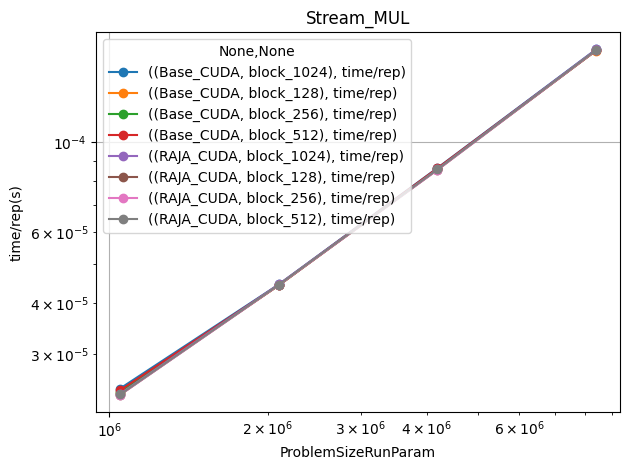

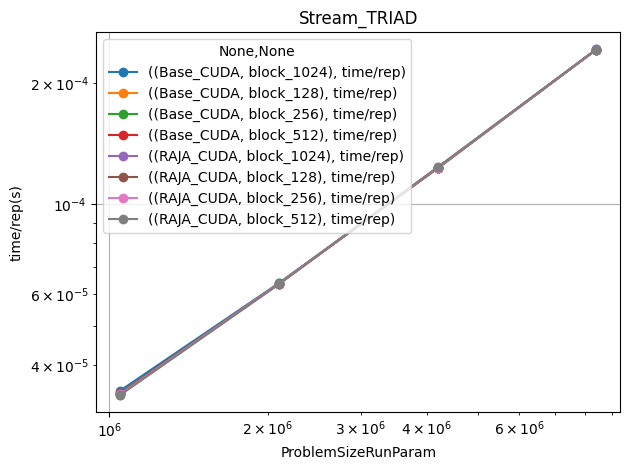

In [8]:
timerep_line_df = plot(
    thicket=tk_var_tun.query(leaf_query, update_inc_cols=False),
    kind="line",
    metric="time/rep",
)

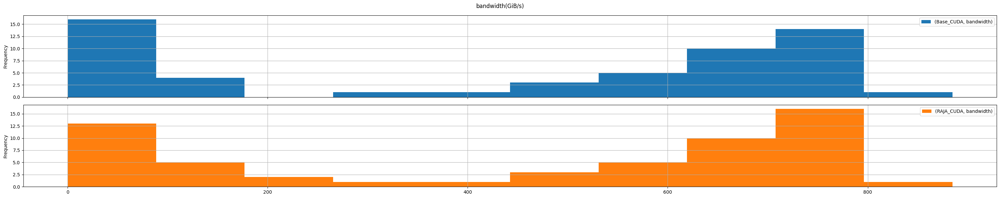

In [9]:
bandwidth_hist_df = plot(
    thicket=tk_var_b128_1M.query(leaf_query, update_inc_cols=False), 
    kind="hist",
    metric="bandwidth",
    prefix="graphs",
)

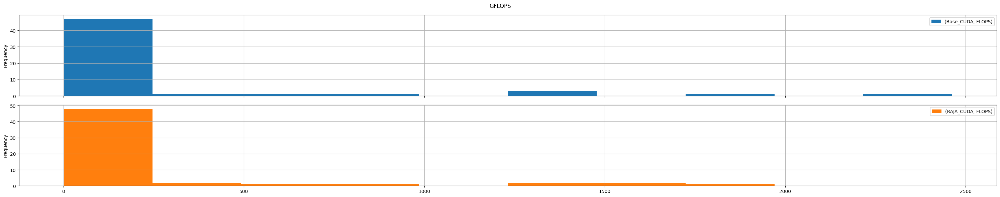

In [10]:
flops_hist_df = plot(
    thicket=tk_var_b128_1M.query(leaf_query, update_inc_cols=False), 
    kind="hist",
    metric="FLOPS",
    prefix="graphs",
)

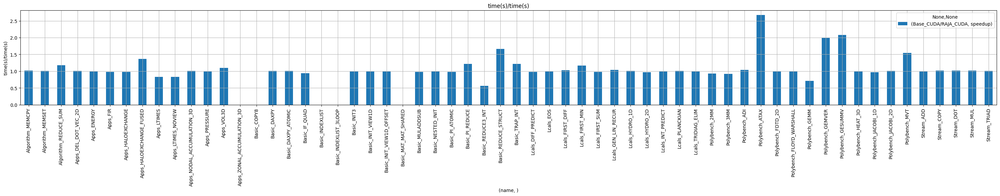

In [11]:
speedup_bar_df = plot(
    thicket=tk_var_b128_1M.query(leaf_query, update_inc_cols=False), 
    kind="bar",
    metric="speedup",
    prefix="graphs",
)

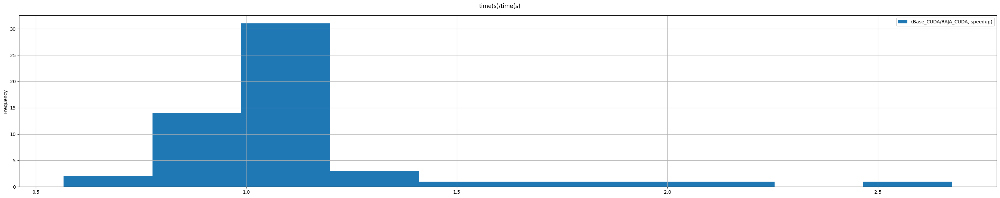

In [12]:
speedup_hist_df = plot(
    thicket=tk_var_b128_1M.query(leaf_query, update_inc_cols=False), 
    kind="hist",
    metric="speedup",
    prefix="graphs",
)

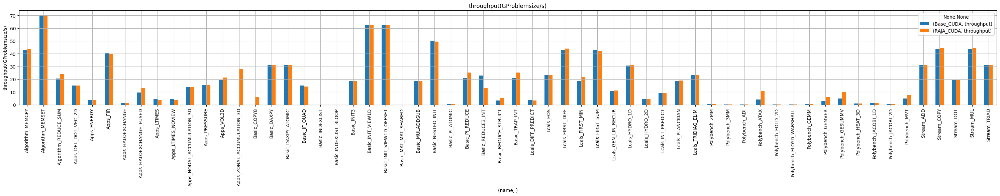

In [13]:
throughput_bar_df = plot(
    thicket=tk_var_b128_1M.query(leaf_query, update_inc_cols=False), 
    kind="bar",
    metric="throughput",
    prefix="graphs",
)